## Data Challenge

 

Apart from the final results, we also want to see your work environment (raw data handling, code, etc) so be ready to share your screen and show us your work and results via zoom. I encourage you to ask questions during the interview, business or technical!

 

In the attached dataset, you’ll find dental claims on a Member level for a benefit year. A data_summary tab is available to provide general guidance on the features.

 

The desired outcome of this data challenge is to:

 

* Perform exploratory data analysis
* Find patterns and correlations where present
* Train a machine learning model to predict the claim amount for the Group Benefit Member ‘sum_paid_amt_after_cob’
    * Start with Ridge, Lasso or ElasticNet Regression (assuming it's a regression question)
* Explain the model with feature importance and feature impact
    * use Shap
 

You can use any tool or program, however please keep in mind that we generally work in Python and present results and visualizations in Tableau (you can get a trial version if you choose to use Tableau). This is just a suggestion, any other tool (like Excel, Power Point, R) would also be acceptable.

### Dependencies

In [1]:
import os
import re
from pprint import PrettyPrinter
pp = PrettyPrinter(indent=4)

import pandas as pd
import plotly.express as px
import numpy as np

import missingno
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
%matplotlib inline

### Examining the Schema

In [2]:
schema = pd.read_excel(
    "data/DataChallenge_GBDentalClaims.xlsx", 
    sheet_name="data_summary"
)
schema

,Feature,Feature Category,Unnamed: 2
0,ee_id,unique ID,NaN
1,sponsor_id,"Sponsor, ex Coca Cola, Nike, etc…",NaN
2,member_id,Employee at a Sponsor,NaN
3,language,Member Demographic,NaN
4,gender,Member Demographic,NaN
...,...,...,...
228,ftr_years_since_cert_effective,Policy Renewal Details,NaN
229,ftr_age_at_renewal,Member age at renewal,NaN
230,MARKET_SEGMENT_ADJ,Sunlife Benefit Type,NaN
231,industry,Sponsor Industry,NaN


In [3]:
pf = ProfileReport(schema)
pf

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Notes from Profiling

* `ftr_policy_median_employee_tenure_days` appears twice in the `Feature` column
* `Unnamed: 2`, from the nullity matrix, has only one value that is not NaN: `TARGET`
* There are common feature categories across features, eg `Member Demographic`, `Dental Claim usage during the most recent benefit year`, etc

#### Identifying the target feature

The target feature that we have identified is `sum_paid_amt_after_cob` which describes `'Dental Claim usage during the most recent benefit year'`.

In [3]:
schema["Unnamed: 2"].unique()

array([nan, 'TARGET '], dtype=object)

In [4]:
# Target Feature
schema[schema["Unnamed: 2"].notna()]

,Feature,Feature Category,Unnamed: 2
13,sum_paid_amt_after_cob,Dental Claim usage during the most recent bene...,TARGET


In [5]:
schema[schema["Unnamed: 2"].notna()]\
    .at[13, "Feature Category"]

'Dental Claim usage during the most recent benefit year'

In [6]:
schema["Feature Category"].value_counts()

Dental Claim usage during the most recent benefit year    50
Prior 1 Year Claim Usage                                  40
Prior 2 Years Claim Usage                                 40
Prior 3 Years Claim Usage                                 39
Employee demographic features                             23
Third Party Environics Information Postal Code Level      15
Dental Policy level information                           14
Policy Renewal Details                                     2
Member Demographic                                         2
Sponsor Industry                                           1
Sunlife Benefit Type                                       1
Member age at renewal                                      1
unique ID                                                  1
Sponsor, ex Coca Cola, Nike, etc…                          1
Member Policy Details                                      1
Employee at a Sponsor                                      1
Member Province         

In [3]:
# first let's take a look at the features who have unique feature categories
# we keep track of them in a list

ones = schema["Feature Category"].value_counts()[schema["Feature Category"].value_counts() == 1].index.to_list()
single_count_cols = []
multi_count_cols = []
for idx, row in schema.iterrows():
    if (row["Feature Category"] in ones):
        single_count_cols.append(row["Feature"])
    else:
        multi_count_cols.append(row["Feature"])
single_count_cols

['ee_id',
 'sponsor_id',
 'member_id',
 'days_exposure_dental',
 'ftr_age_at_renewal',
 'MARKET_SEGMENT_ADJ',
 'industry',
 'province']

In [8]:
# this gives context to the features in the single_count_cols list
# it looks like a few of these are just identifiers

data = []
for i in single_count_cols:
    data.append({k: list(v.values())[0] for k, v in schema.loc[schema["Feature"]==i, :].to_dict().items()})

sc_df = pd.DataFrame(data)
sc_df

,Feature,Feature Category,Unnamed: 2
0,ee_id,unique ID,NaN
1,sponsor_id,"Sponsor, ex Coca Cola, Nike, etc…",NaN
2,member_id,Employee at a Sponsor,NaN
3,days_exposure_dental,Member Policy Details,NaN
4,ftr_age_at_renewal,Member age at renewal,NaN
5,MARKET_SEGMENT_ADJ,Sunlife Benefit Type,NaN
6,industry,Sponsor Industry,NaN
7,province,Member Province,NaN


In [9]:
# this gives context to the features in the multi_count_cols list
data = []
for i in multi_count_cols:
    data.append(
        {k: list(v.values())[0] for k, v in schema.loc[schema["Feature"]==i, :].to_dict().items()}
    )

mc_df = pd.DataFrame(data)
mc_df

,Feature,Feature Category,Unnamed: 2
0,language,Member Demographic,NaN
1,gender,Member Demographic,NaN
2,pol_renewal_dt,Dental Policy level information,NaN
3,num_claims,Dental Claim usage during the most recent bene...,NaN
4,total_num_serv_lines,Dental Claim usage during the most recent bene...,NaN
...,...,...,...
220,ftr_env_pct_household_3person,Third Party Environics Information Postal Code...,NaN
221,ftr_env_pct_household_4person,Third Party Environics Information Postal Code...,NaN
222,ftr_env_pct_household_5person,Third Party Environics Information Postal Code...,NaN
223,pol_renewal_yr,Policy Renewal Details,NaN


In [10]:
schema.loc[schema["Feature Category"]=="Policy Renewal Details", :]

,Feature,Feature Category,Unnamed: 2
227,pol_renewal_yr,Policy Renewal Details,NaN
228,ftr_years_since_cert_effective,Policy Renewal Details,NaN


In [11]:
# just looking at "Dental Claim usage during the most recent benefit year" Features
schema.loc[schema["Feature Category"]=="Dental Claim usage during the most recent benefit year", :]

,Feature,Feature Category,Unnamed: 2
7,num_claims,Dental Claim usage during the most recent bene...,NaN
8,total_num_serv_lines,Dental Claim usage during the most recent bene...,NaN
9,sum_charge_amt,Dental Claim usage during the most recent bene...,NaN
10,sum_paid_amt,Dental Claim usage during the most recent bene...,NaN
11,sum_adj_amt,Dental Claim usage during the most recent bene...,NaN
12,sum_paid_amt_cldld,Dental Claim usage during the most recent bene...,NaN
13,sum_paid_amt_after_cob,Dental Claim usage during the most recent bene...,TARGET
14,sum_lab_chrg_amt,Dental Claim usage during the most recent bene...,NaN
15,num_claims_dep,Dental Claim usage during the most recent bene...,NaN
16,total_num_serv_lines_dep,Dental Claim usage during the most recent bene...,NaN


## Exploring the Dataset

In [4]:
dataset = pd.read_excel(
    "data/DataChallenge_GBDentalClaims.xlsx", 
    sheet_name="dataset"
)
dataset

,ee_id,policy number,member_id,language,gender,pol_renewal_dt,days_exposure_dental,num_claims,total_num_serv_lines,sum_charge_amt,...,ftr_env_pct_household_2person,ftr_env_pct_household_3person,ftr_env_pct_household_4person,ftr_env_pct_household_5person,pol_renewal_yr,ftr_years_since_cert_effective,ftr_age_at_renewal,MARKET_SEGMENT_ADJ,industry,province
0,3433_3433,3433,3433,E,M,2018-06-01,365,NaN,NaN,NaN,...,0.272997,0.181009,0.148368,0.183976,2018,1.750685,50.750685,SUNADVANTAGE,retail_trade,ontario
1,3433_38,3433,38,E,M,2017-06-01,365,NaN,NaN,NaN,...,0.483271,0.111524,0.083643,0.029740,2017,5.254795,54.613699,SUNADVANTAGE,retail_trade,ontario
2,3447_8,3447,8,E,F,2019-06-01,366,5.0,16.0,1366.0,...,0.327586,0.068966,0.034483,0.000000,2019,11.257534,51.739726,SUNADVANTAGE,service_repair_business,ontario
3,3473_9,3473,9,E,M,2017-06-01,365,NaN,NaN,NaN,...,0.314815,0.055556,0.018519,0.000000,2017,9.257534,45.279452,SUNSOLUTIONS,service_repair_business,saskatchewan
4,3498_1073,3498,1073,E,M,2019-07-01,366,2.0,8.0,402.0,...,0.434783,0.130435,0.173913,0.043478,2019,0.246575,47.646575,SUNADVANTAGE,manufacturing,ontario
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7995,187950_22,187950,22,E,M,2019-12-01,195,3.0,11.0,1036.1,...,0.200000,0.100000,0.200000,0.400000,2019,1.334247,31.586301,SUNADVANTAGE,wholesale_trade,british_columbia
7996,187953_25,187953,25,E,F,2019-12-01,366,NaN,NaN,NaN,...,0.329897,0.164948,0.123711,0.051546,2019,1.334247,44.978082,SUNADVANTAGE,manufacturing,british_columbia
7997,187976_64,187976,64,E,M,2019-12-01,323,3.0,7.0,845.0,...,0.486284,0.102244,0.069825,0.037406,2019,-0.117808,57.117808,SUNADVANTAGE,manufacturing,ontario
7998,187986_29,187986,29,E,F,2019-12-01,366,NaN,NaN,NaN,...,0.330357,0.205357,0.133929,0.000000,2019,0.586301,27.484932,SUNADVANTAGE,finance_insurance_real_estate,ontario


In [14]:
dataset.dtypes

ee_id                              object
policy number                       int64
member_id                          object
language                           object
gender                             object
                                   ...   
ftr_years_since_cert_effective    float64
ftr_age_at_renewal                float64
MARKET_SEGMENT_ADJ                 object
industry                           object
province                           object
Length: 233, dtype: object

In [15]:
dataset.describe().T

,count,mean,std,min,25%,50%,75%,max
policy number,8000.0,83225.450125,57741.340551,3433.000000,25277.000000,78180.000000,150237.250000,187990.00000
days_exposure_dental,8000.0,314.606500,99.948519,1.000000,344.000000,365.000000,365.000000,366.00000
num_claims,5051.0,5.314591,4.427571,1.000000,2.000000,4.000000,7.000000,49.00000
total_num_serv_lines,5051.0,14.934666,12.082607,1.000000,6.000000,11.000000,20.000000,114.00000
sum_charge_amt,5051.0,1814.719036,2221.059836,27.140000,525.000000,1099.000000,2252.500000,24669.00000
...,...,...,...,...,...,...,...,...
ftr_env_pct_household_4person,7301.0,0.167322,0.111493,0.000000,0.090909,0.159091,0.241379,1.00000
ftr_env_pct_household_5person,7301.0,0.108383,0.131247,0.000000,0.024096,0.080645,0.142857,1.00000
pol_renewal_yr,8000.0,2018.173625,0.767172,2017.000000,2018.000000,2018.000000,2019.000000,2019.00000
ftr_years_since_cert_effective,8000.0,4.964452,6.418374,-1.000000,0.706849,2.587671,7.005479,45.19726


#### Looking at the Max's and Mins of the Target Column

In [13]:
# looking at the top 10 highest Sum paid amount after collaboration of benefits
dataset.nlargest(10, 'sum_paid_amt_after_cob')\
    .sort_values('sum_paid_amt_after_cob', ascending=False)

,ee_id,policy number,member_id,language,gender,pol_renewal_dt,days_exposure_dental,num_claims,total_num_serv_lines,sum_charge_amt,...,ftr_env_pct_household_2person,ftr_env_pct_household_3person,ftr_env_pct_household_4person,ftr_env_pct_household_5person,pol_renewal_yr,ftr_years_since_cert_effective,ftr_age_at_renewal,MARKET_SEGMENT_ADJ,industry,province
6596,150772_106791,150772,106791,E,M,2019-09-01,366,25.0,53.0,10121.00,...,0.170732,0.243902,0.268293,0.219512,2019,0.736986,45.232877,NATIONAL ACCOUNTS,service_repair_business,unknown
2264,25449_22866,25449,22866,E,F,2017-09-01,272,26.0,50.0,19993.00,...,0.151515,0.272727,0.303030,0.121212,2017,20.857534,49.183562,NATIONAL ACCOUNTS,educational_services,ontario
5192,101915_400391,101915,400391,E,M,2018-03-01,365,24.0,62.0,13615.00,...,0.435065,0.087662,0.064935,0.048701,2018,2.000000,43.542466,SUNSOLUTIONS,oil_industry,alberta
2458,25495_922798,25495,922798,E,F,2018-01-01,365,16.0,63.0,16634.75,...,0.235294,0.235294,0.176471,0.117647,2018,0.786301,47.334247,NATIONAL ACCOUNTS,transportation_communication_public_utilities,unknown
2378,25495_915117,25495,915117,E,M,2019-01-01,365,37.0,95.0,11406.70,...,0.333333,0.222222,0.222222,0.111111,2019,0.542466,47.241096,NATIONAL ACCOUNTS,transportation_communication_public_utilities,unknown
39,4109_102837,4109,102837,E,F,2019-11-01,366,27.0,62.0,21602.74,...,0.166667,0.222222,0.222222,0.333333,2019,11.005479,40.101370,NATIONAL ACCOUNTS,wholesale_trade,quebec
4385,87037_103353,87037,103353,E,F,2017-04-01,365,35.0,85.0,13386.00,...,0.135135,0.108108,0.324324,0.378378,2017,6.205479,34.506849,SUNSOLUTIONS,hospital,ontario
6105,150320_128838,150320,128838,E,M,2018-01-01,365,18.0,64.0,9172.32,...,0.238095,0.166667,0.261905,0.214286,2018,5.002740,54.375342,NATIONAL ACCOUNTS,transportation_communication_public_utilities,unknown
4574,100315_606712,100315,606712,E,M,2017-04-01,365,20.0,52.0,18750.20,...,0.307692,0.153846,0.153846,0.153846,2017,7.005479,59.021918,NATIONAL ACCOUNTS,manufacturing,british_columbia
6196,150368_1000274,150368,1000274,E,M,2019-01-01,365,30.0,74.0,14689.50,...,0.400000,0.200000,0.166667,0.066667,2019,6.002740,40.109589,NATIONAL ACCOUNTS,manufacturing,unknown


In [98]:
# looking at the top 10 lowest Sum paid amount after collaboration of benefits
dataset.nsmallest(10, 'sum_paid_amt_after_cob')\
    .sort_values('sum_paid_amt_after_cob', ascending=False)

,ee_id,policy number,member_id,language,gender,pol_renewal_dt,days_exposure_dental,num_claims,total_num_serv_lines,sum_charge_amt,sum_paid_amt,sum_adj_amt,sum_paid_amt_cldld,sum_paid_amt_after_cob,sum_lab_chrg_amt,num_claims_dep,total_num_serv_lines_dep,sum_charge_amt_dep,sum_paid_amt_dep,sum_adj_amt_dep,sum_paid_amt_cldld_dep,sum_paid_amt_after_cob_dep,sum_dent_chrg_amt_dep,sum_lab_chrg_amt_dep,num_claims_exam,num_claims_scaling,num_claims_crowns,num_claims_restorations,num_claims_endodontic,num_claims_extractions,num_claims_polish,num_claims_bridgework,num_claims_root_planing,num_claims_orthodontic,num_claims_dentures,num_claims_anesthesia,num_claims_recall_exam,num_claims_xray,num_claims_bruxism_appliance,num_claims_denturist_services,amt_paid_after_cob_exam,amt_paid_after_cob_scaling,amt_paid_after_cob_crowns,amt_paid_after_cob_restorations,amt_paid_after_cob_endodontic,amt_paid_after_cob_extractions,amt_paid_after_cob_polish,amt_paid_after_cob_bridgework,amt_paid_after_cob_root_planing,amt_paid_after_cob_orthodontic,amt_paid_after_cob_dentures,amt_paid_after_cob_anesthesia,amt_paid_after_cob_recall_exam,amt_paid_after_cob_xray,amt_paid_after_cob_bruxism_appliance,amt_paid_after_cob_denturist_services,ftr_employee_age_as_of_renewal,ftr_employee_spouse_age_as_of_renewal,ftr_employee_son_age_as_of_renewal,ftr_employee_daughter_age_as_of_renewal,ftr_employee_household_size,ftr_employee_number_dependents,ftr_employee_number_children_dependent,ftr_employee_number_other_dependent,ftr_employee_spouse_dependent_flag,ftr_employee_children_dependent_flag,ftr_employee_number_students_household,ftr_employee_number_handicap_household,ftr_employee_student_presence_flag,ftr_employee_handicap_presence_flag,ftr_employee_number_male_household,ftr_employee_number_female_household,ftr_employee_male_presence_flag,ftr_employee_female_presence_flag,ftr_employee_number_deaths_recorded_household,ftr_employee_amt_sal,ftr_employee_days_since_last_salary_change,ftr_employee_days_since_employment,cde_marital_status_eeeb,ftr_employee_retire_flag,ftr_policy_num_employee,ftr_policy_avg_employee_age_as_of_renewal,ftr_policy_q25_employee_age_as_of_renewal,ftr_policy_q75_employee_age_as_of_renewal,ftr_policy_pct_female,ftr_policy_pct_member_w_spouse,ftr_policy_pct_member_w_children,ftr_policy_avg_stu_in_household,num_pol_eert_ret_ftr,ftr_policy_num_retire,ftr_policy_pct_retire,ftr_policy_median_salary,ftr_policy_median_employee_tenure_days,prior1yr_num_claims,prior1yr_total_num_serv_lines,prior1yr_sum_charge_amt,prior1yr_sum_paid_amt_after_cob,prior1yr_num_claims_dep,prior1yr_total_num_serv_lines_dep,prior1yr_sum_charge_amt_dep,prior1yr_sum_paid_amt_after_cob_dep,prior1yr_num_claims_exam,prior1yr_num_claims_scaling,prior1yr_num_claims_crowns,prior1yr_num_claims_restorations,prior1yr_num_claims_endodontic,prior1yr_num_claims_extractions,prior1yr_num_claims_polish,prior1yr_num_claims_bridgework,prior1yr_num_claims_root_planing,prior1yr_num_claims_orthodontic,prior1yr_num_claims_dentures,prior1yr_num_claims_anesthesia,prior1yr_num_claims_recall_exam,prior1yr_num_claims_xray,prior1yr_num_claims_bruxism_appliance,prior1yr_num_claims_denturist_services,prior1yr_amt_paid_after_cob_exam,prior1yr_amt_paid_after_cob_scaling,prior1yr_amt_paid_after_cob_crowns,prior1yr_amt_paid_after_cob_restorations,prior1yr_amt_paid_after_cob_endodontic,prior1yr_amt_paid_after_cob_extractions,prior1yr_amt_paid_after_cob_polish,prior1yr_amt_paid_after_cob_bridgework,prior1yr_amt_paid_after_cob_root_planing,prior1yr_amt_paid_after_cob_orthodontic,prior1yr_amt_paid_after_cob_dentures,prior1yr_amt_paid_after_cob_anesthesia,prior1yr_amt_paid_after_cob_recall_exam,prior1yr_amt_paid_after_cob_xray,prior1yr_amt_paid_after_cob_bruxism_appliance,prior1yr_amt_paid_after_cob_denturist_services,prior2yr_num_claims,prior2yr_total_num_serv_lines,prior2yr_sum_charge_amt,prior2yr_sum_paid_amt_after_cob,prior2yr_num_claims_dep,prior2yr_total_num_serv_lines_dep,prior2yr_sum_charge_amt_dep,prior2yr_sum_

#### Notes

The largest `sum_paid_amt_after_cob` claims come from:

    * National Accounts
    * transportation_communication_public_utilies
    * from unknown province, ontario, alberta

The smallest `sum_paid_amt_after_cob` claims come from:

    * Sun Advantage market segment
    * retail trade, service repair business
    * from ontario, saskatchewan


### Looking at Correlations

In [16]:
_large_corrs = dataset.nlargest(10, 'sum_paid_amt_after_cob')\
    .sort_values('sum_paid_amt_after_cob', ascending=False).corr()

In [41]:
# Features with mid-strong correlations with the TARGET sum_paid_amt_after_cob
pos_matrix = dataset.corr()[dataset.corr().gt(0.3)]
dataset_corr_strong_pos = pos_matrix['sum_paid_amt_after_cob']\
    .dropna()\
    .sort_values(ascending=False)

print(len(dataset_corr_strong_pos), " features are mid-strongly correlated to TARGET")
display(dataset_corr_strong_pos)

56  features are mid-strongly correlated to TARGET


sum_paid_amt                               1.000000
sum_paid_amt_after_cob                     1.000000
sum_adj_amt                                0.993512
sum_paid_amt_cldld                         0.972304
sum_paid_amt_dep                           0.844418
sum_paid_amt_after_cob_dep                 0.844418
sum_adj_amt_dep                            0.841352
sum_paid_amt_cldld_dep                     0.812865
num_claims                                 0.788585
sum_charge_amt                             0.775395
total_num_serv_lines                       0.760757
sum_dent_chrg_amt_dep                      0.697625
sum_charge_amt_dep                         0.683008
num_claims_dep                             0.665697
total_num_serv_lines_dep                   0.640883
amt_paid_after_cob_restorations            0.568669
num_claims_restorations                    0.565358
num_claims_recall_exam                     0.511214
prior1yr_sum_paid_amt_after_cob            0.506030
prior1yr_tot

In [44]:
fig = px.imshow(pos_matrix.corr())
fig.show()

#### Notes

* Strong Positive Correlations with Target (sum_paid_amt_after_cob)

        sum_paid_amt                               1.000000
        sum_paid_amt_after_cob                     1.000000
        sum_adj_amt                                0.993512
        sum_paid_amt_cldld                         0.972304
        sum_paid_amt_dep                           0.844418
        sum_paid_amt_after_cob_dep                 0.844418
        sum_adj_amt_dep                            0.841352
        sum_paid_amt_cldld_dep                     0.812865
        num_claims                                 0.788585
        sum_charge_amt                             0.775395
        total_num_serv_lines                       0.760757
        sum_dent_chrg_amt_dep                      0.697625
        sum_charge_amt_dep                         0.683008
        num_claims_dep                             0.665697
        total_num_serv_lines_dep                   0.640883
        amt_paid_after_cob_restorations            0.568669
        num_claims_restorations                    0.565358
        num_claims_recall_exam                     0.511214
        prior1yr_sum_paid_amt_after_cob            0.506030
        prior1yr_total_num_serv_lines              0.487532
        prior1yr_num_claims                        0.480734
        prior1yr_sum_paid_amt_after_cob_dep        0.472494
        prior1yr_total_num_serv_lines_dep          0.457335
        prior1yr_num_claims_dep                    0.447529
        amt_paid_after_cob_recall_exam             0.445264
        prior1yr_amt_paid_after_cob_recall_exam    0.437094
        num_claims_scaling                         0.412970
        prior2yr_sum_paid_amt_after_cob            0.405310
        prior2yr_total_num_serv_lines              0.402803
        prior1yr_num_claims_recall_exam            0.399291
        prior2yr_num_claims                        0.398672
        ftr_employee_household_size                0.385135
        ftr_employee_number_dependents             0.383468
        prior2yr_total_num_serv_lines_dep          0.381142
        prior1yr_sum_charge_amt                    0.372816
        prior2yr_num_claims_dep                    0.371400
        prior1yr_sum_charge_amt_dep                0.369347
        prior2yr_sum_paid_amt_after_cob_dep        0.368417
        amt_paid_after_cob_scaling                 0.360339
        prior3yr_sum_paid_amt_after_cob            0.359146
        prior2yr_amt_paid_after_cob_recall_exam    0.354585
        prior3yr_num_claims                        0.353619
        prior3yr_total_num_serv_lines              0.352952
        prior3yr_total_num_serv_lines_dep          0.333498
        prior2yr_sum_charge_amt                    0.331867
        prior2yr_num_claims_recall_exam            0.331165
        prior3yr_num_claims_dep                    0.331057
        prior3yr_sum_paid_amt_after_cob_dep        0.330584
        ftr_employee_number_children_dependent     0.328193
        prior3yr_amt_paid_after_cob_recall_exam    0.326644
        ftr_employee_spouse_dependent_flag         0.321059
        ftr_employee_children_dependent_flag       0.317026
        prior2yr_sum_charge_amt_dep                0.307840
        amt_paid_after_cob_extractions             0.303321
        prior3yr_num_claims_recall_exam            0.302396
        prior1yr_amt_paid_after_cob_scaling        0.300628


We will want to feature select-out features that are too strongly coupled with the TARGET.

In [38]:
# Features with negative correlations with the TARGET sum_paid_amt_after_cob
dataset_corr_strong_neg = dataset.corr()[dataset.corr().lt(0.0)]['sum_paid_amt_after_cob']\
    .dropna()\
    .sort_values(ascending=False)

print(len(dataset_corr_strong_neg), " features are negatively correlated to TARGET")
display(dataset_corr_strong_neg)

11  features are negatively correlated to TARGET


prior2yr_amt_paid_after_cob_dentures     -0.000625
prior3yr_amt_paid_after_cob_anesthesia   -0.003746
ftr_employee_retire_flag                 -0.023772
ftr_env_total_population                 -0.024643
ftr_env_total_households                 -0.030292
ftr_env_pct_movers                       -0.033901
ftr_policy_pct_female                    -0.036074
ftr_env_pct_household_2person            -0.055662
ftr_policy_num_employee                  -0.091862
ftr_env_pct_rented                       -0.096695
ftr_env_pct_household_1person            -0.109818
Name: sum_paid_amt_after_cob, dtype: float64

#### Notes

* Strong Negative Correlations

        prior2yr_amt_paid_after_cob_dentures     -0.000625
        prior3yr_amt_paid_after_cob_anesthesia   -0.003746
        ftr_employee_retire_flag                 -0.023772
        ftr_env_total_population                 -0.024643
        ftr_env_total_households                 -0.030292
        ftr_env_pct_movers                       -0.033901
        ftr_policy_pct_female                    -0.036074
        ftr_env_pct_household_2person            -0.055662
        ftr_policy_num_employee                  -0.091862
        ftr_env_pct_rented                       -0.096695
        ftr_env_pct_household_1person            -0.109818

There are no strong negative correlations with the target.

We take note here of the columns that are unique to the schema that don't appear
in the actual dataset

In [6]:
single_count_cols
multi_count_cols
a = set(dataset.columns)
b = set(single_count_cols)
c = set(multi_count_cols)

print("Single Cols from schema not in dataset:\n", b.difference(a), "\n")
print("Multi Cols from schema not in dataset:\n", c.difference(a))

Single Cols from schema not in dataset:
 {'sponsor_id'} 

Multi Cols from schema not in dataset:
 {'Ftr_policy_median_employee_tenure_days', 'ftr_env_pct_household_200p'}


this gives us an idea of the value spread across single_count_cols

In [5]:
# for i in single_count_cols:
#     try:
#         print(i)
#         print(dataset[i].value_counts(dropna=False).sort_values(ascending=False))
#         print()
#     except:
#         pass

In [49]:
# looking at clai 
for i in range(1, 11):
    num = dataset["member_id"].value_counts()[dataset["member_id"].value_counts() > i]
    print(
        "{}% of the members made more than {} claims in this period"\
            .format(
                round((len(num)/dataset["member_id"].nunique()) * 100, 2), 
                i
            )
    )

4.02% of the members made more than 1 claims in this period
1.76% of the members made more than 2 claims in this period
1.21% of the members made more than 3 claims in this period
0.99% of the members made more than 4 claims in this period
0.81% of the members made more than 5 claims in this period
0.68% of the members made more than 6 claims in this period
0.64% of the members made more than 7 claims in this period
0.49% of the members made more than 8 claims in this period
0.42% of the members made more than 9 claims in this period
0.38% of the members made more than 10 claims in this period


In [7]:
# looking at members who have claimed dental benefits more than 5 times

v_c = dataset.member_id.value_counts()
fivetimes = dataset[dataset.member_id.isin(v_c.index[v_c.gt(5)])]
fivetimes_agg = fivetimes[["member_id", "MARKET_SEGMENT_ADJ", "province", "industry", "sum_paid_amt_after_cob"]]\
    .groupby(["member_id", "MARKET_SEGMENT_ADJ", "province", "industry"])\
    .agg(['sum', 'max', 'min', 'mean'])\

# if not os.path.exists("data/heavy_claimers.csv"):
#     fivetimes_agg.to_csv("data/heavy_claimers.csv", index=False)

In [8]:
fivetimes.isnull().sum()[fivetimes.isnull().sum() > 0]

num_claims                       283
total_num_serv_lines             283
sum_charge_amt                   283
sum_paid_amt                     283
sum_adj_amt                      283
                                ... 
ftr_env_pct_household_1person     19
ftr_env_pct_household_2person     19
ftr_env_pct_household_3person     19
ftr_env_pct_household_4person     19
ftr_env_pct_household_5person     19
Length: 63, dtype: int64

In [121]:
dataset.style.background_gradient(cmap='Reds', axis=0)

In [83]:
fivetimes_agg.style.background_gradient(cmap='Reds', axis=0)

#### Notes

* members can claim from more than 1 `MARKET_SEGMENT_ADJ`
* members can have a history of claiming from more than one `province` and sponsor `industry`

#### Notes

* a small portion of the members make the majority of dental benefit claims

    
    4.02% of the members made more than 1 claims in this period
    1.76% of the members made more than 2 claims in this period
    1.21% of the members made more than 3 claims in this period
    0.99% of the members made more than 4 claims in this period
    0.81% of the members made more than 5 claims in this period
    0.68% of the members made more than 6 claims in this period
    0.64% of the members made more than 7 claims in this period
    0.49% of the members made more than 8 claims in this period
    0.42% of the members made more than 9 claims in this period
    0.38% of the members made more than 10 claims in this period


* The majority of claims/entries comes have had a years-worth (364-365) of `days_exposure_dental`


* majority of claims from:

        * ontario
        * unknown
        * quebec
        * alberta
        * british columbia
        * saskatchewan
    

In [85]:
dataset.describe().T.style.background_gradient(cmap='Blues', axis=0)

,count,mean,std,min,25%,50%,75%,max
policy number,8000.000000,83225.450125,57741.340551,3433.000000,25277.000000,78180.000000,150237.250000,187990.000000
days_exposure_dental,8000.000000,314.606500,99.948519,1.000000,344.000000,365.000000,365.000000,366.000000
num_claims,5051.000000,5.314591,4.427571,1.000000,2.000000,4.000000,7.000000,49.000000
total_num_serv_lines,5051.000000,14.934666,12.082607,1.000000,6.000000,11.000000,20.000000,114.000000
sum_charge_amt,5051.000000,1814.719036,2221.059836,27.140000,525.000000,1099.000000,2252.500000,24669.000000
sum_paid_amt,5051.000000,1100.486163,1109.119092,0.000000,365.000000,751.720000,1462.000000,9619.000000
sum_adj_amt,5051.000000,1088.407462,1101.929518,-1313.120000,358.555000,750.000000,1457.185000,9619.000000
sum_paid_amt_cldld,5051.000000,1180.342465,1171.333379,0.000000,388.050000,821.000000,1575.000000,11010.340000
sum_paid_amt_after_cob,8000.000000,694.819451,1028.847205,0.000000,0.000000,313.600000,998.985000,9619.000000
sum_lab_chrg_amt,5051.000000,91.435888,378.846018,0.000000,0.000000,0.000000,0.000000,6651.000000


### High Level Dataset Profiling

In [71]:
# This crashed my computer at around 75%
# %%time
# pf = ProfileReport(dataset)
# pf

### Data Types

In [15]:
dataset.dtypes

ee_id                              object
policy number                       int64
member_id                          object
language                           object
gender                             object
                                   ...   
ftr_years_since_cert_effective    float64
ftr_age_at_renewal                float64
MARKET_SEGMENT_ADJ                 object
industry                           object
province                           object
Length: 233, dtype: object

In [16]:
dataset.select_dtypes('datetime64[ns]')

,pol_renewal_dt
0,2018-06-01
1,2017-06-01
2,2019-06-01
3,2017-06-01
4,2019-07-01
...,...
7995,2019-12-01
7996,2019-12-01
7997,2019-12-01
7998,2019-12-01


#### Seeing if there are any temporal trends

In [17]:
dataset[["pol_renewal_dt", "sum_paid_amt_after_cob"]]\
    .groupby(["pol_renewal_dt"])\
    .agg(["median", "mean", "min", "max", "sum", "count"])\
    .style.background_gradient(cmap="Reds", axis=0)

#### Notes
<br>

* January 2019 was the month of the highest volume of dental claims with 1112 claims followed by January 2018. We might be able to assume that Januaries are the busiest months for claim processing.

* All claims in the dataset are dated for the first of the month, save for one that was processed on November 17, 2017, which may or may not be mis-dated, or can be included alongside the November 2017 records

* September 2019 had the highest value of claims in this subset, followed by July 2017

* There have been dental claims for \$0

* Aside from the claim of Nov 2017 that might be an 'error', April 2017 had the highest mean claim with Sept 2019 having the lowest mean claim

* Aside from the claim of Nov 2017 that might be an error, the median claim amount was \$637.055000 in August 2018

* Sept 2019, Sept 2018, Sept 2017 have median claims of $0 - also months in which the majority of claims are processed.



### Examining Claim Policy Popularity

In [69]:
dataset["policy number"].value_counts(dropna=False)[dataset["policy number"].value_counts(dropna=False) > 40]

50149     215
25495     130
56003     120
17895     107
50196     106
22275     100
20640      78
22258      75
20577      71
15236      70
83640      65
25087      62
25273      58
20575      56
23227      52
25212      49
150320     46
25371      44
50832      41
25252      41
Name: policy number, dtype: int64

#### Notes

Policy `50149` is the most popular policy followed by `25495`, and `56003`

### Geographic Patterns in Claimage

In [74]:
dataset["province"].value_counts(dropna=False, normalize=True)\
    .reset_index(drop=False)\
    .style.background_gradient(cmap='Reds')

,index,province
0,ontario,0.343875
1,unknown,0.315750
2,quebec,0.176250
3,alberta,0.064500
4,british_columbia,0.041500
5,saskatchewan,0.014500
6,nova_scotia,0.006250
7,manitoba,0.006000
8,california,0.003875
9,newfoundland,0.003500


In [77]:
pct = dataset["province"].value_counts(dropna=False, normalize=True)\
    .reset_index(drop=False)[:5]["province"].sum() * 100
provinces = dataset["province"].value_counts(dropna=False, normalize=True)\
    .reset_index(drop=False)[:5]["index"]

print(f"These are the provinces that account for {round(pct, 3)}% of the dental claims:\n{provinces}")

These are the provinces that account for 94.187% of the dental claims:
0             ontario
1             unknown
2              quebec
3             alberta
4    british_columbia
Name: index, dtype: object


### Notes


These are the provinces that account for 94.187% of the dental claims: ontario,  unknown, quebec, alberta, british_columbia

In [20]:
# attempt to convert datatypes
dataset = dataset.convert_dtypes()

## Examining Nullity

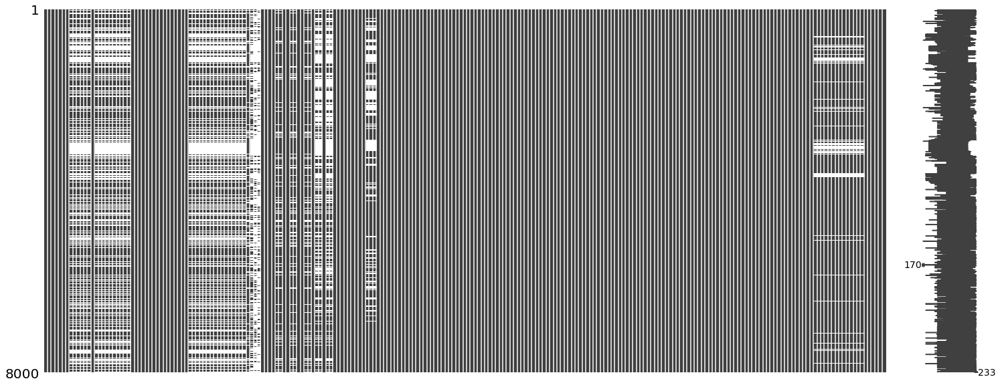

In [22]:
missingno.matrix(dataset)
plt.show()

#### Notes

There seems to be distinct structure to the nature of the missing data, by the looks of the nullity matrix and the sparkline on the RHS.

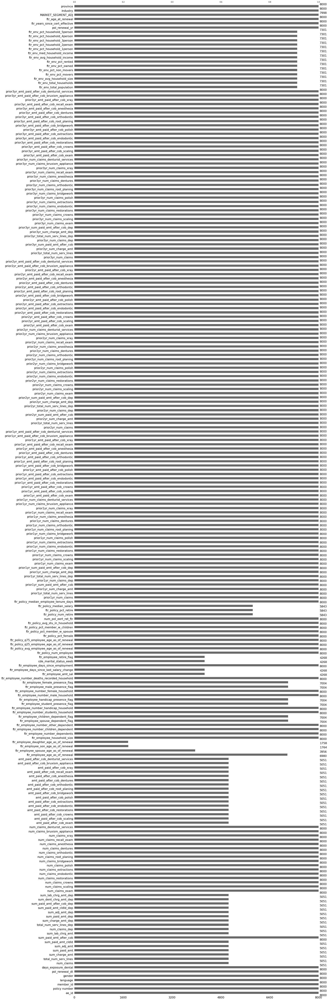

In [55]:
missingno.bar(dataset)
plt.show()

In [12]:
cols_having_nans = dataset.isnull().sum()[dataset.isnull().sum() > 0].sort_values(ascending=False)
for idx, i in zip(cols_having_nans.index, cols_having_nans):
    print(idx, i)

ftr_employee_daughter_age_as_of_renewal 6242
ftr_employee_son_age_as_of_renewal 6236
ftr_employee_spouse_age_as_of_renewal 4044
ftr_employee_days_since_last_salary_change 3732
ftr_employee_amt_sal 3732
ftr_employee_retire_flag 3732
cde_marital_status_eeeb 3732
total_num_serv_lines 2949
amt_paid_after_cob_denturist_services 2949
amt_paid_after_cob_endodontic 2949
amt_paid_after_cob_xray 2949
amt_paid_after_cob_recall_exam 2949
amt_paid_after_cob_anesthesia 2949
amt_paid_after_cob_dentures 2949
amt_paid_after_cob_orthodontic 2949
amt_paid_after_cob_root_planing 2949
amt_paid_after_cob_bridgework 2949
amt_paid_after_cob_polish 2949
amt_paid_after_cob_bruxism_appliance 2949
num_claims 2949
amt_paid_after_cob_restorations 2949
sum_charge_amt_dep 2949
sum_charge_amt 2949
sum_paid_amt 2949
sum_adj_amt 2949
sum_paid_amt_cldld 2949
sum_lab_chrg_amt 2949
num_claims_dep 2949
amt_paid_after_cob_crowns 2949
total_num_serv_lines_dep 2949
sum_paid_amt_dep 2949
sum_adj_amt_dep 2949
sum_paid_amt_cldld_

#### Note

Many features are missing the same number of entries. 

Some of the data from these columns are 'missing' because they may not be applicable or the member did not want to report that information:

    ftr_employee_daughter_age_as_of_renewal 6242
    ftr_employee_son_age_as_of_renewal 6236
    ftr_employee_spouse_age_as_of_renewal 4044
    ftr_employee_days_since_last_salary_change 3732

Perhaps there are some common characteristics among the records with the missing values.

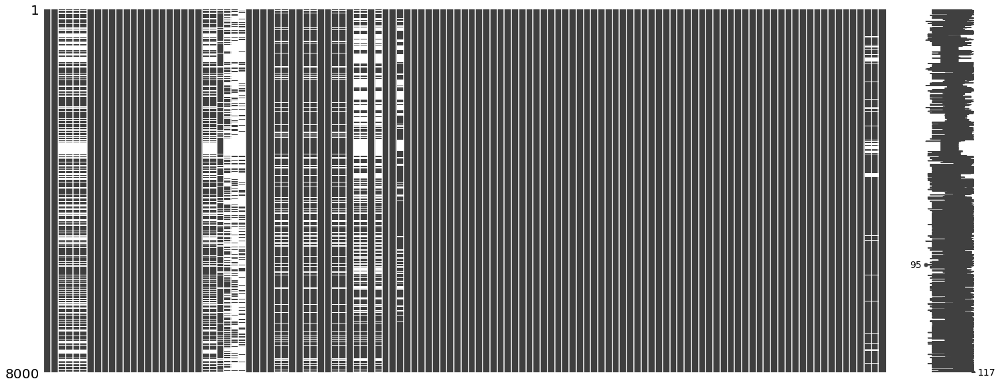

In [23]:
# seeing if there are any nullity patterns obvious with the numeric data
missingno.matrix(dataset.select_dtypes(['int64', 'float32']))
plt.show()

In [64]:
# Almost every entry in the dataset has missing values
print(
    "{}% of the columns contains at least 1 missing value".\
    format((1-(len(dataset.dropna())/len(dataset))) * 100)
)
display(dataset.dropna())

93.7625% of the columns contains at least 1 missing value


,ee_id,policy number,member_id,language,gender,pol_renewal_dt,days_exposure_dental,num_claims,total_num_serv_lines,sum_charge_amt,...,ftr_env_pct_household_2person,ftr_env_pct_household_3person,ftr_env_pct_household_4person,ftr_env_pct_household_5person,pol_renewal_yr,ftr_years_since_cert_effective,ftr_age_at_renewal,MARKET_SEGMENT_ADJ,industry,province
27,3981_3,3981,3,E,M,2017-10-01,365,11,39,4294.91,...,0.294118,0.205882,0.264706,0.117647,2017,9.257534,40.320548,SUNADVANTAGE,agriculture,unknown
28,4004_181,4004,181,E,M,2018-10-01,365,13,51,7361.37,...,0.266667,0.233333,0.266667,0.133333,2018,1.556164,51.358904,SUNSOLUTIONS,service_repair_business,alberta
34,4108_20159,4108,20159,E,F,2017-09-01,365,4,12,2185.5,...,0.172414,0.172414,0.241379,0.37931,2017,4.994521,45.438356,SUNSOLUTIONS,finance_insurance_real_estate,ontario
39,4109_102837,4109,102837,E,F,2019-11-01,366,27,62,21602.74,...,0.166667,0.222222,0.222222,0.333333,2019,11.005479,40.10137,NATIONAL ACCOUNTS,wholesale_trade,quebec
40,4109_262912,4109,262912,E,F,2018-11-01,365,13,57,6504.0,...,0.285714,0.285714,0.285714,0.071429,2018,0.213699,50.123288,NATIONAL ACCOUNTS,wholesale_trade,quebec
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7963,186391_21,186391,21,E,M,2019-07-01,181,10,26,2816.0,...,0.270833,0.1875,0.229167,0.104167,2019,0.145205,37.241096,SUNADVANTAGE,retail_trade,quebec
7971,186797_103216,186797,103216,E,M,2019-09-01,366,10,25,5062.7,...,0.302326,0.232558,0.232558,0.186047,2019,0.205479,48.290411,SUNADVANTAGE,service_repair_business,ontario
7981,187280_126,187280,126,E,M,2019-10-01,366,1,4,1019.7,...,0.296296,0.185185,0.037037,0.037037,2019,1.068493,25.778082,SUNADVANTAGE,service_repair_business,ontario
7985,187514_61,187514,61,E,M,2019-11-01,205,5,15,3138.86,...,0.375,0.125,0.208333,0.125,2019,0.336986,31.556164,SUNADVANTAGE,oil_industry,alberta


#### Note

With so many missing values, we can't simply drop all rows with any values missing. That would mean essentially scrapping most of the dataset, which we want to avoid for as long as possible.

In [32]:
# examining only the columns in the dataset with category 
# feature = "Dental Claim usage during the most recent benefit year"

dental_cols = schema.loc[
    schema[
        "Feature Category"]=="Dental Claim usage during the most recent benefit year", :
    ].Feature.unique()

bool_mask = dataset.columns.isin(dental_cols)
cols = dataset.columns[bool_mask]
dental_ds = dataset[cols]

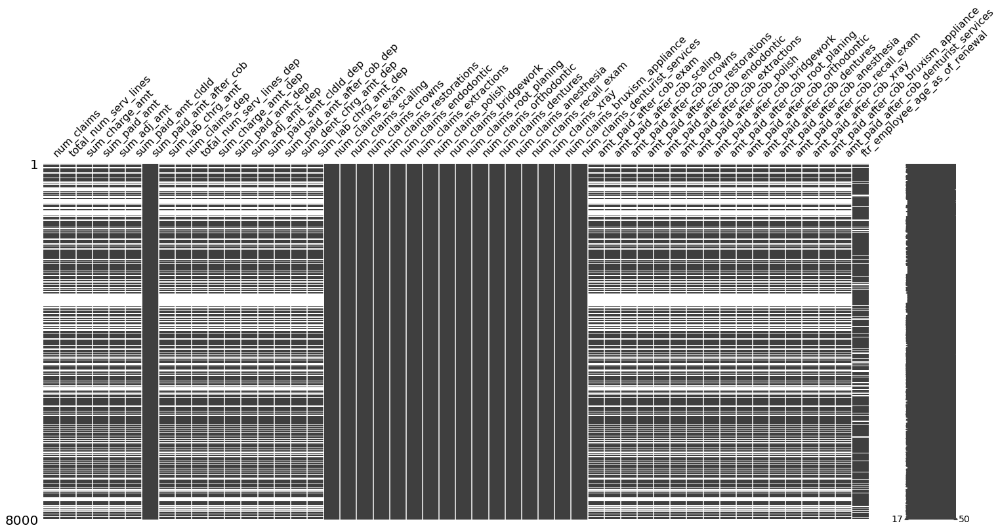

In [33]:
missingno.matrix(dental_ds)
plt.show()

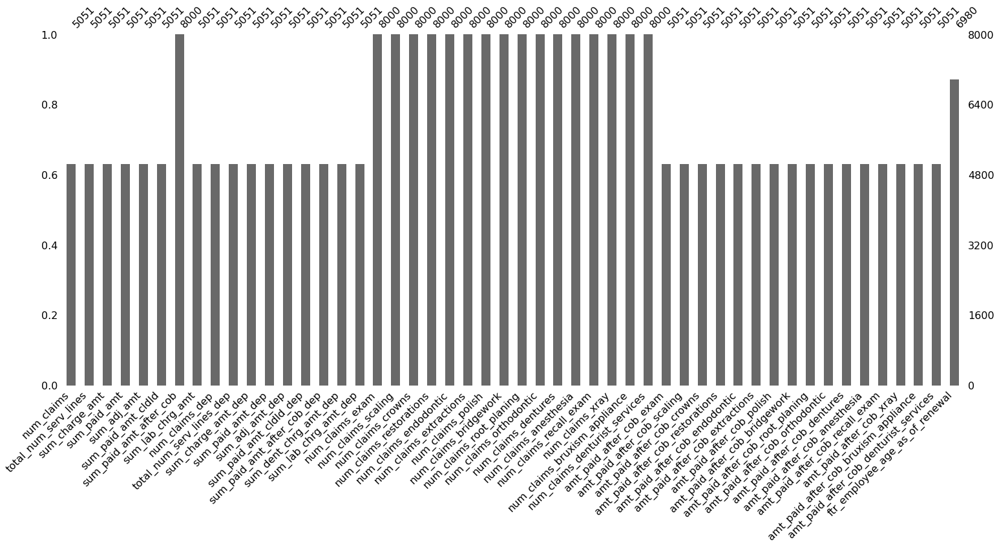

In [53]:
# missing data profile of dental_ds
missingno.bar(dental_ds)
plt.show()

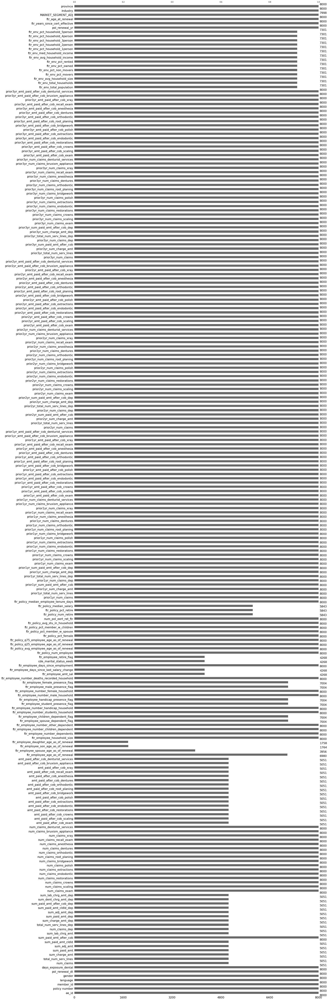

In [16]:
# compare with nullity plot for entire dataset
missingno.bar(dataset)
plt.show()

In [43]:
# Entry with the least nullity as indicated by the sparkline
dental_ds.loc[50].hasnans

False

In [52]:
# Entry with the most nullity, as indicated by the sparkline
dental_ds.loc[17, :].to_dict()

{'num_claims': 1.0,
 'total_num_serv_lines': 3.0,
 'sum_charge_amt': 391.9,
 'sum_paid_amt': 223.08,
 'sum_adj_amt': 223.08,
 'sum_paid_amt_cldld': 223.08,
 'sum_paid_amt_after_cob': 223.08,
 'sum_lab_chrg_amt': 0.0,
 'num_claims_dep': 0.0,
 'total_num_serv_lines_dep': 0.0,
 'sum_charge_amt_dep': 0.0,
 'sum_paid_amt_dep': 0.0,
 'sum_adj_amt_dep': 0.0,
 'sum_paid_amt_cldld_dep': 0.0,
 'sum_paid_amt_after_cob_dep': 0.0,
 'sum_dent_chrg_amt_dep': 0.0,
 'sum_lab_chrg_amt_dep': 0.0,
 'num_claims_exam': 1.0,
 'num_claims_scaling': 0.0,
 'num_claims_crowns': 0.0,
 'num_claims_restorations': 0.0,
 'num_claims_endodontic': 0.0,
 'num_claims_extractions': 0.0,
 'num_claims_polish': 0.0,
 'num_claims_bridgework': 0.0,
 'num_claims_root_planing': 0.0,
 'num_claims_orthodontic': 0.0,
 'num_claims_dentures': 0.0,
 'num_claims_anesthesia': 0.0,
 'num_claims_recall_exam': 0.0,
 'num_claims_xray': 0.0,
 'num_claims_bruxism_appliance': 0.0,
 'num_claims_denturist_services': 0.0,
 'amt_paid_after_cob_exa

#### Visualizing the data with reduced Dimensions using UMAP

In [80]:
values = {}

for c in dataset.select_dtypes(['int64', 'float32']).columns:
    if dataset[c].dtype == "float32":
        values[c] = dataset[c].mean()
    elif dataset[c].dtype == "int64":
        values[c] = dataset[c].mode()

values

{'policy number': 0    50149
 dtype: int64,
 'days_exposure_dental': 0    365
 dtype: int64,
 'num_claims_exam': 0    0
 dtype: int64,
 'num_claims_scaling': 0    0
 dtype: int64,
 'num_claims_crowns': 0    0
 dtype: int64,
 'num_claims_restorations': 0    0
 dtype: int64,
 'num_claims_endodontic': 0    0
 dtype: int64,
 'num_claims_extractions': 0    0
 dtype: int64,
 'num_claims_polish': 0    0
 dtype: int64,
 'num_claims_bridgework': 0    0
 dtype: int64,
 'num_claims_root_planing': 0    0
 dtype: int64,
 'num_claims_orthodontic': 0    0
 dtype: int64,
 'num_claims_dentures': 0    0
 dtype: int64,
 'num_claims_anesthesia': 0    0
 dtype: int64,
 'num_claims_recall_exam': 0    0
 dtype: int64,
 'num_claims_xray': 0    0
 dtype: int64,
 'num_claims_bruxism_appliance': 0    0
 dtype: int64,
 'num_claims_denturist_services': 0    0
 dtype: int64,
 'ftr_employee_household_size': 0    1
 dtype: int64,
 'ftr_employee_number_dependents': 0    0
 dtype: int64,
 'ftr_employee_number_children_

/home/dennis/Desktop/Mini-project/venv/lib/python3.8/site-packages/sklearn/manifold/_spectral_embedding.py:260: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


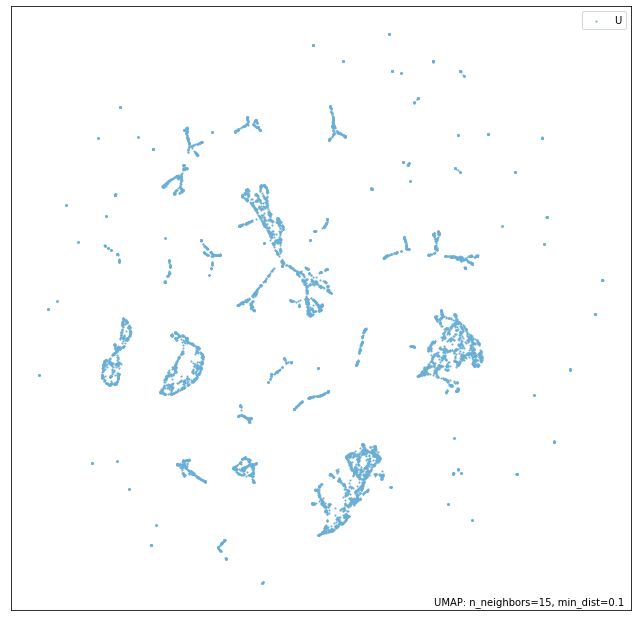

In [82]:
import umap
import umap.plot

mapper = umap.UMAP()\
    .fit(
        dataset.select_dtypes(['int64', 'float32'])\
            .fillna(value=values)
    )
umap.plot.points(mapper)
plt.legend("UMAP Feature Reduction")
plt.show()

### Notes

Visually, there does not seem to be much global structure to the data, however, we can see that there are pockets of local structure.

# Findings

From the cursory EDA and visualizations we can note several patterns in this particular dataset:


* The claims in the dataset are processed or entered each on the first of each month, save for one entry that was dated for Nov 17, 2017 (perhaps an error)
* The month of January typically have the highest volume and total sum of claims followed by September.
* Many members make more than one claim however a small portion of the members have had more than 11 claims as heavy users - however this does not necessarily mean that their claims are the most expensive.
* Sponsory industry for claims can vary widely
* Multiple claims from the same member can be made from many geographical provinces/states, sometimes left as unknown - The majority of which are from Canada (Ontario, Unknown, Quebec, Alberta, British Columbia and Saskatchewan)
* There are 56 moderately-to strongly correlated features in the dataset
* The nullity matrix tells us that there are is structure or purpose to missing values
* Nullity in the data in some features indicates non-applicability
* From the UMAP dimensionality reduction visualization, we can see local features appearing prominently, whereas global structure is not present or very weak
